# Lab 08 
## Phan Hồng Trâm_21110414

In [1]:
import numpy as np 
import pandas as pd
import cv2 
from matplotlib import pyplot as plt 
import matplotlib.cm as cm
import matplotlib.gridspec as gridspec
from pylab import imread
from skimage.color import rgb2gray

C:\Users\PC\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


In [2]:
# Xử lý đường dẫn
import os
import requests
os.chdir('C:/Users/PC/Desktop/CODE/PY/DIP/lab08/image')

# Hàm show ảnh

In [3]:
def ShowImage(ImageList, nRows = 1, nCols = 2, WidthSpace = 0.00, HeightSpace = 0.00):
    from matplotlib import pyplot as plt 
    import matplotlib.gridspec as gridspec
    
    gs = gridspec.GridSpec(nRows, nCols)     
    gs.update(wspace=WidthSpace, hspace=HeightSpace) # set the spacing between axes.
    plt.figure(figsize=(20,10))
    for i in range(len(ImageList)):
        ax1 = plt.subplot(gs[i])
        ax1.set_xticklabels([])
        ax1.set_yticklabels([])
        ax1.set_aspect('equal')

        plt.subplot(nRows, nCols,i+1)

        image = ImageList[i].copy()
        if (len(image.shape) < 3):
            plt.imshow(image, plt.cm.gray)
        else:
            plt.imshow(image)
        plt.title("Image " + str(i))
        plt.axis('off')

    plt.show()

# Hàm lấy thông tin ảnh

In [4]:
def InfoImage(IM):
    Image = IM
    Width = Image.shape[1]
    Height = Image.shape[0]
    Channel = len(Image.shape)
    print("Width : ", Width, " Height : ", Height, " Channel : ", Channel)
    
    if(Channel == 2):
        print("Min Intensity: ", IM.min(), " Max Intensity: ", IM.max())
    else:
        print("Red - Min Intensity: ", IM[:,:,0].min(), " Max Intensity: ", IM[:,:,0].max())
        print("Green - Min Intensity: ", IM[:,:,1].min(), " Max Intensity: ", IM[:,:,1].max())
        print("Blue - Min Intensity: ", IM[:,:,2].min(), " Max Intensity: ", IM[:,:,2].max()) 

# Hàm resize ảnh

In [5]:
def ResizeImage(IM, DesiredWidth, DesiredHeight):
    from skimage.transform import rescale, resize
    
    OrigWidth = float(IM.shape[1])
    OrigHeight = float(IM.shape[0])
    Width = DesiredWidth 
    Height = DesiredHeight

    if((Width == 0) & (Height == 0)):
        return IM
    
    if(Width == 0):
        Width = int((OrigWidth * Height)/OrigHeight)

    if(Height == 0):
        Height = int((OrigHeight * Width)/OrigWidth)

    dim = (Width, Height)
#     print(dim)
    resizedIM = cv2.resize(IM, dim, interpolation = cv2.INTER_NEAREST) 
#     imshows([IM, resizedIM], ["Image", "resizedIM"],1,2)
    return resizedIM

# 1/ Kiếm 1 ảnh từ internet thực hiện các thao tác biến đổi sau bằng cách gọi hàm từ các thư viện (opencv hay skimage hay bất kỳ thư viện nào)

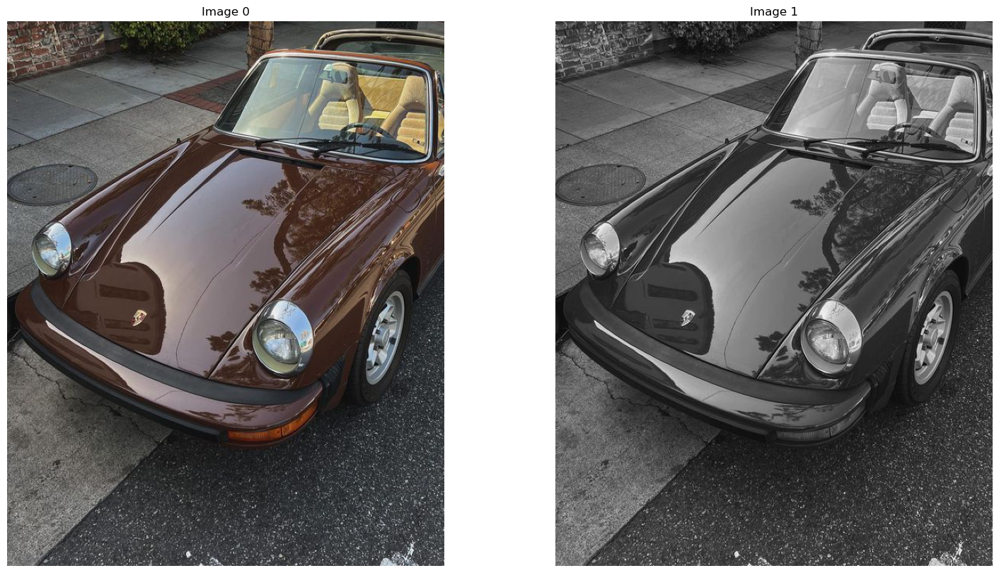

In [6]:
# Read Image 
image_1 = imread("car.jpg")

# Convert Image into Gray
image_gray_1 = cv2.cvtColor(image_1, cv2.COLOR_RGB2GRAY)

# Display Image
ShowImage([image_1, image_gray_1], 1, 2)

## Scaling


 image_color :
Width :  564  Height :  703  Channel :  3
Red - Min Intensity:  0  Max Intensity:  255
Green - Min Intensity:  0  Max Intensity:  255
Blue - Min Intensity:  0  Max Intensity:  255

 image_scale01 :
Width :  282  Height :  703  Channel :  3
Red - Min Intensity:  0  Max Intensity:  255
Green - Min Intensity:  0  Max Intensity:  255
Blue - Min Intensity:  0  Max Intensity:  255

 image_scale02 :
Width :  282  Height :  352  Channel :  3
Red - Min Intensity:  0  Max Intensity:  255
Green - Min Intensity:  0  Max Intensity:  255
Blue - Min Intensity:  0  Max Intensity:  255

 image_scale03 :
Width :  564  Height :  352  Channel :  3
Red - Min Intensity:  0  Max Intensity:  255
Green - Min Intensity:  0  Max Intensity:  255
Blue - Min Intensity:  0  Max Intensity:  255


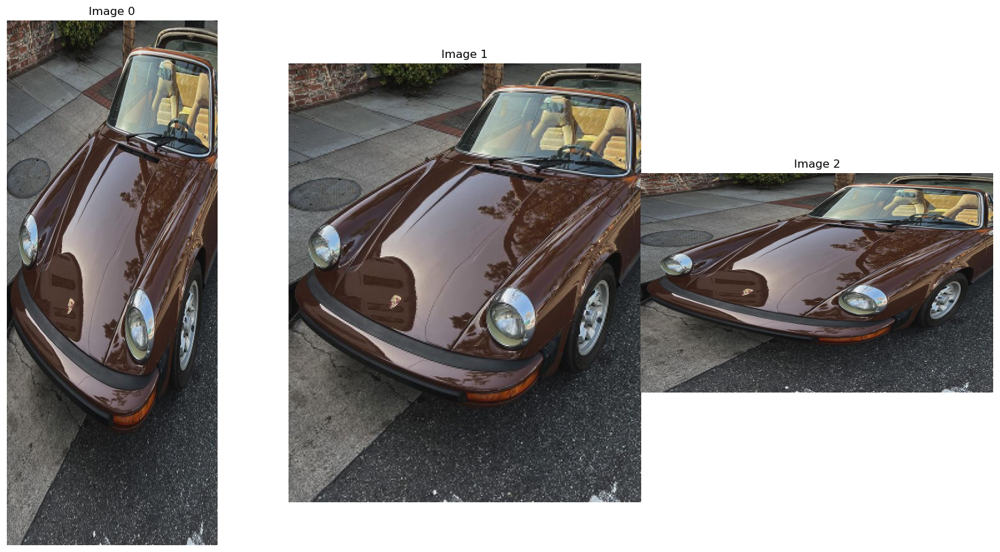

In [7]:
image_scale01 = cv2.resize(image_1,None,fx=0.5, fy=1, interpolation = cv2.INTER_CUBIC)
image_scale02 = cv2.resize(image_1,None,fx=0.5, fy=0.5, interpolation = cv2.INTER_CUBIC)
image_scale03 = cv2.resize(image_1,None,fx=1, fy=0.5, interpolation = cv2.INTER_CUBIC)

print("\n image_color :")
InfoImage(image_1)
print("\n image_scale01 :")
InfoImage(image_scale01)
print("\n image_scale02 :")
InfoImage(image_scale02)
print("\n image_scale03 :")
InfoImage(image_scale03)

ShowImage([image_scale01, image_scale02, image_scale03], 1, 3)

## Rotation (30, 45, 60, 90, 120, 160, 180)

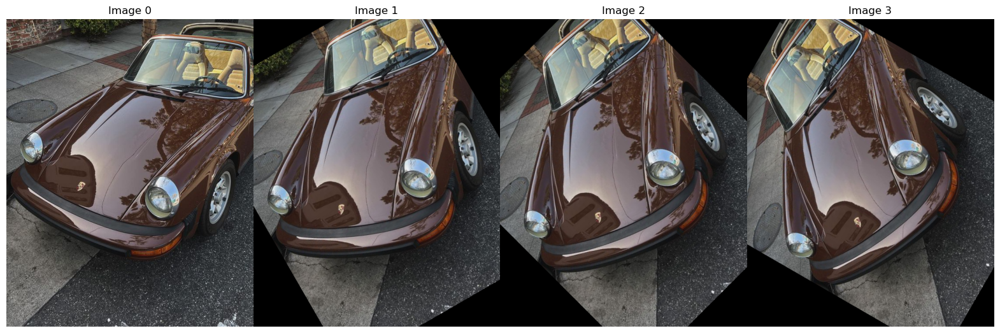

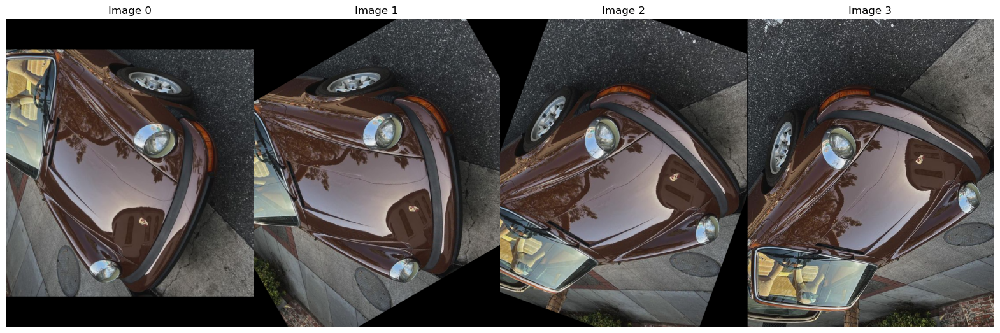

In [8]:
rows,cols  = image_1.shape[:2]
RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),30,1)
image_rotation01 = cv2.warpAffine(image_1,RotationMatrix,(cols,rows))

RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),45,1)
image_rotation02 = cv2.warpAffine(image_1,RotationMatrix,(cols,rows))

RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),60,1)
image_rotation03 = cv2.warpAffine(image_1,RotationMatrix,(cols,rows))

RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),90,1)
image_rotation04 = cv2.warpAffine(image_1,RotationMatrix,(cols,rows))

RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),120,1)
image_rotation05 = cv2.warpAffine(image_1,RotationMatrix,(cols,rows))

RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),160,1)
image_rotation06 = cv2.warpAffine(image_1,RotationMatrix,(cols,rows))

RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),180,1)
image_rotation07 = cv2.warpAffine(image_1,RotationMatrix,(cols,rows))

ShowImage([image_1, image_rotation01, image_rotation02, image_rotation03], 1, 4)
ShowImage([image_rotation04, image_rotation05, image_rotation06, image_rotation07], 1, 4)

## Translation

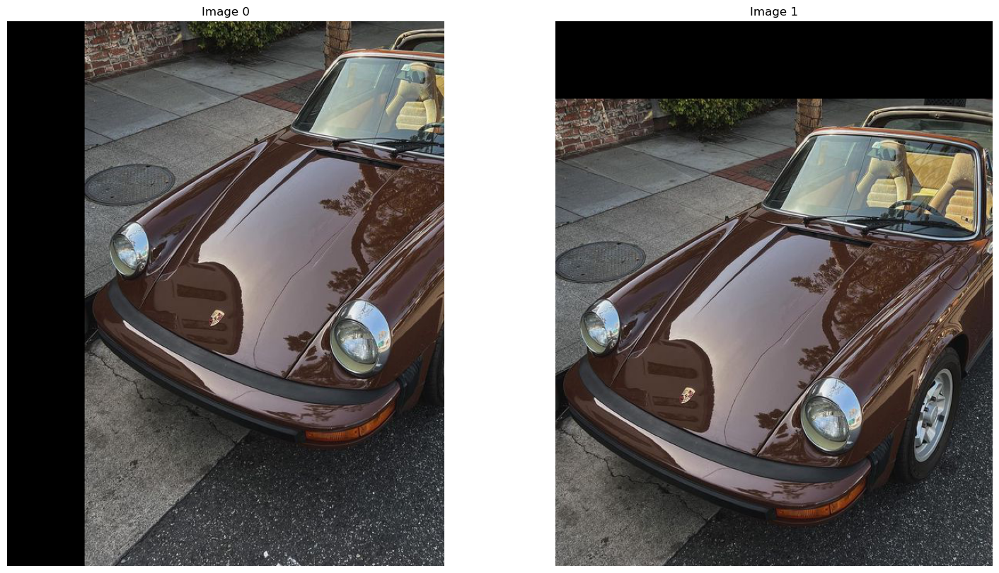

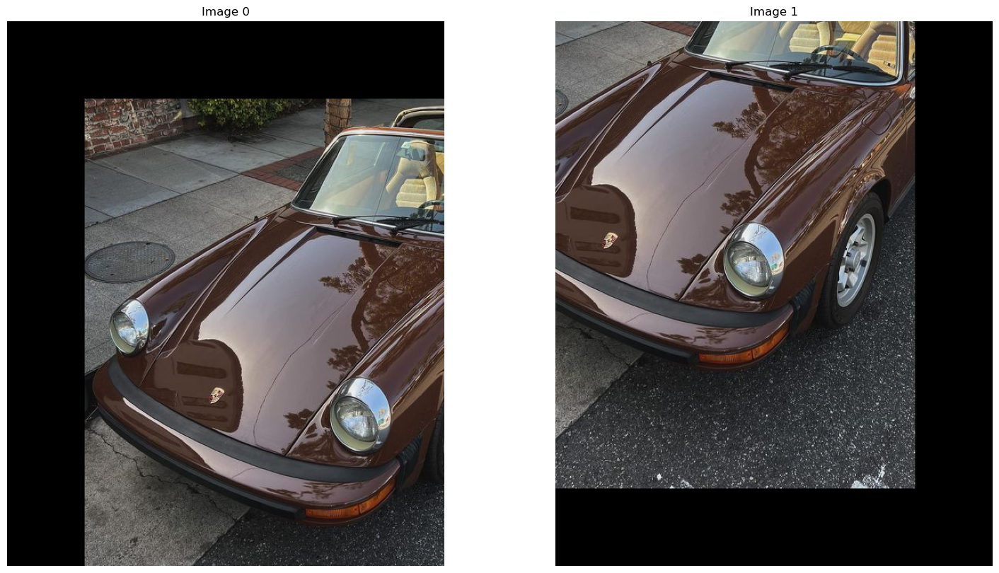

In [9]:
# Translation
rows,cols  = image_1.shape[:2]

TranslationMatrix = np.float32([[1,0,100],[0,1,0]])
image_translation01 = cv2.warpAffine(image_1,TranslationMatrix,(cols,rows))

TranslationMatrix = np.float32([[1,0,0],[0,1,100]])
image_translation02 = cv2.warpAffine(image_1,TranslationMatrix,(cols,rows))

TranslationMatrix = np.float32([[1,0,100],[0,1,100]])
image_translation03 = cv2.warpAffine(image_1,TranslationMatrix,(cols,rows))

TranslationMatrix = np.float32([[1,0,-100],[0,1,-100]])
image_translation04 = cv2.warpAffine(image_1,TranslationMatrix,(cols,rows))

ShowImage([image_translation01, image_translation02], 1, 2)
ShowImage([image_translation03, image_translation04], 1, 2)

## Shearing

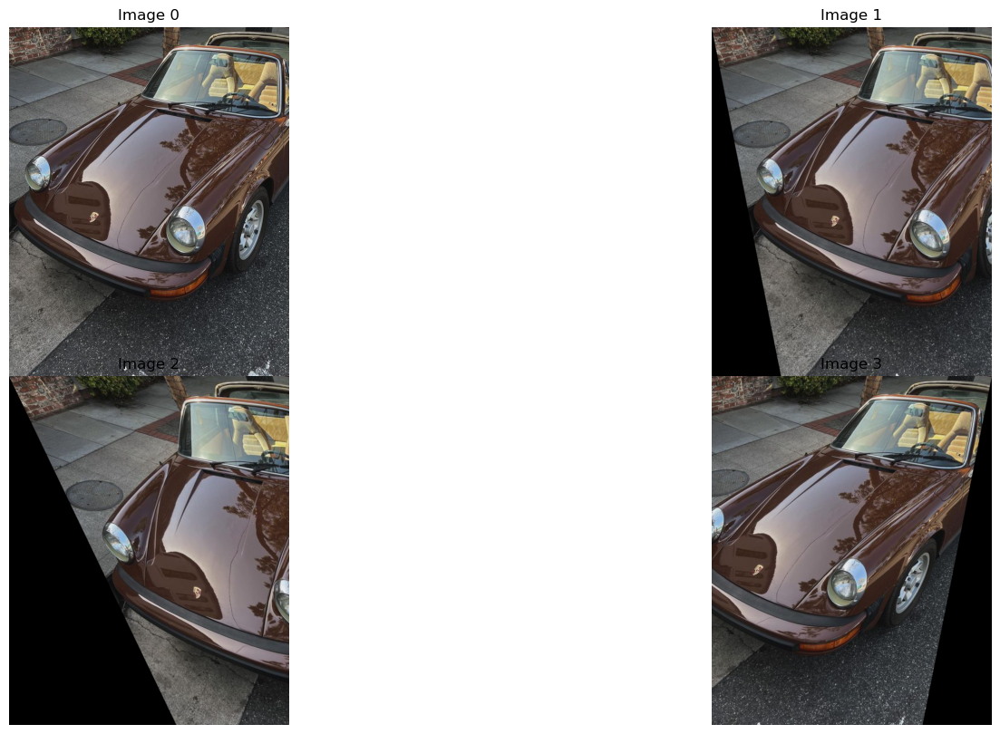

In [10]:
from skimage import transform as tf

# Create Afine transform
afine_tf = tf.AffineTransform(shear=0.2)
image_shear01 = tf.warp(image_1, inverse_map=afine_tf)

afine_tf = tf.AffineTransform(shear=0.5)
image_shear02 = tf.warp(image_1, inverse_map=afine_tf)

afine_tf = tf.AffineTransform(shear=-0.2)
image_shear03 = tf.warp(image_1, inverse_map=afine_tf)

ShowImage([image_1, image_shear01, image_shear02, image_shear03], 2, 2)

# 2/ Kiếm 1 ảnh từ internet thực hiện các thao tác biến đổi sau bằng cách nhân thông qua ma trận biến đổi  


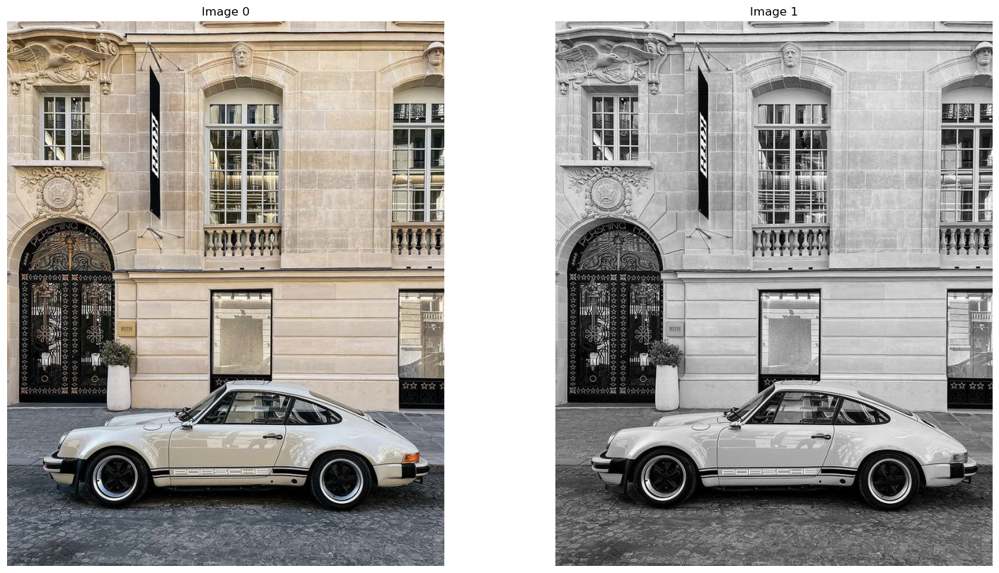

In [11]:
from skimage import data, transform

# Read Image 
image_2 = imread("car_porsche.jpg")
# Convert Image into Gray
image_gray_2 = cv2.cvtColor(image_2, cv2.COLOR_RGB2GRAY)

# Display Image
ShowImage([image_2, image_gray_2], 1, 2)

## Scaling

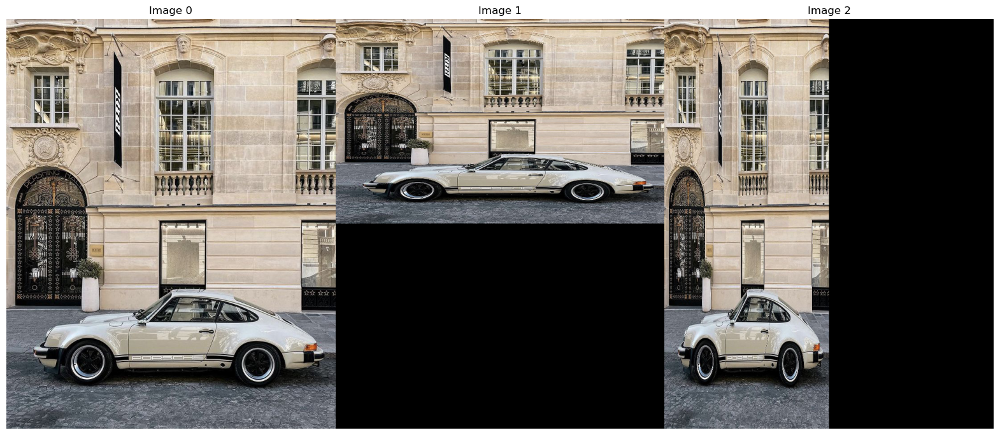

In [12]:
rows, cols, dim = image_2.shape

#transformation matrix for Scaling
M = np.float32([[1, 0  , 0],
                [0,   0.5, 0],
                [0,   0,   1]])

M1 = np.float32([[0.5, 0  , 0],
                [0,   1, 0],
                [0,   0,   1]])

# apply a perspective transformation to the image
scaled_img1 = cv2.warpPerspective(image_2,M,(cols,rows))
scaled_img2 = cv2.warpPerspective(image_2,M1,(cols,rows))

ShowImage([image_2, scaled_img1, scaled_img2], 1, 3)

## Rotation (30, 45, 60, 90, 120, 160, 180)

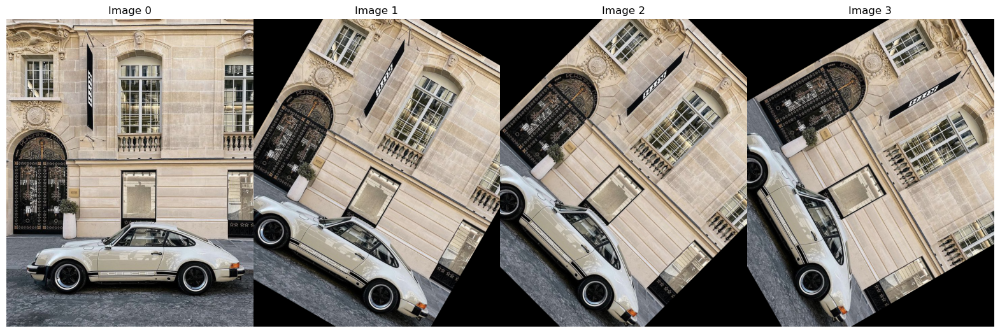

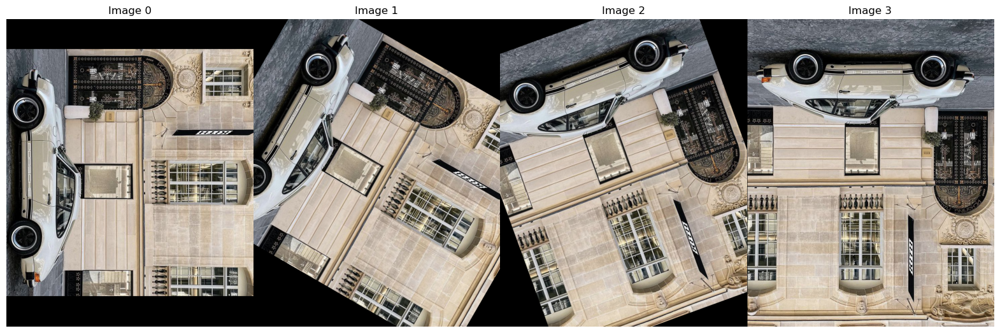

In [13]:
rows, cols, dim = image_2.shape
xc, yc = cols/2, rows/2

Translate = np.float32([[1, 0  , xc],
                        [0,   1, yc],
                        [0,   0,   1]])

Translate_op = np.float32([[1, 0  , -xc],
                        [0,   1, -yc],
                        [0,   0,   1]])

# angle from degree to radian
angle = np.radians(30)
M = np.float32([[np.cos(angle), -(np.sin(angle)), 0],
            	[np.sin(angle), np.cos(angle), 0],
            	[0, 0, 1]])
M1 = Translate @ M @ Translate_op

angle = np.radians(45)
M = np.float32([[np.cos(angle), -(np.sin(angle)), 0],
            	[np.sin(angle), np.cos(angle), 0],
            	[0, 0, 1]])
M2 = Translate @ M @ Translate_op

angle = np.radians(60)
M = np.float32([[np.cos(angle), -(np.sin(angle)), 0],
            	[np.sin(angle), np.cos(angle), 0],
            	[0, 0, 1]])
M3 = Translate @ M @ Translate_op

angle = np.radians(90)
M = np.float32([[np.cos(angle), -(np.sin(angle)), 0],
            	[np.sin(angle), np.cos(angle), 0],
            	[0, 0, 1]])
M4 = Translate @ M @ Translate_op

angle = np.radians(120)
M = np.float32([[np.cos(angle), -(np.sin(angle)), 0],
            	[np.sin(angle), np.cos(angle), 0],
            	[0, 0, 1]])
M5 = Translate @ M @ Translate_op

angle = np.radians(160)
M = np.float32([[np.cos(angle), -(np.sin(angle)), 0],
            	[np.sin(angle), np.cos(angle), 0],
            	[0, 0, 1]])
M6 = Translate @ M @ Translate_op

angle = np.radians(180)
M = np.float32([[np.cos(angle), -(np.sin(angle)), 0],
            	[np.sin(angle), np.cos(angle), 0],
            	[0, 0, 1]])
M7 = Translate @ M @ Translate_op

# apply a perspective transformation to the image
rotated_img1 = cv2.warpPerspective(image_2, M1, (cols,rows))
rotated_img2 = cv2.warpPerspective(image_2, M2, (cols,rows))
rotated_img3 = cv2.warpPerspective(image_2, M3, (cols,rows))
rotated_img4 = cv2.warpPerspective(image_2, M4, (cols,rows))
rotated_img5 = cv2.warpPerspective(image_2, M5, (cols,rows))
rotated_img6 = cv2.warpPerspective(image_2, M6, (cols,rows))
rotated_img7 = cv2.warpPerspective(image_2, M7, (cols,rows))

ShowImage([image_2, rotated_img1, rotated_img2, rotated_img3], 1, 4)
ShowImage([rotated_img4, rotated_img5, rotated_img6, rotated_img7], 1, 4)

## Translation

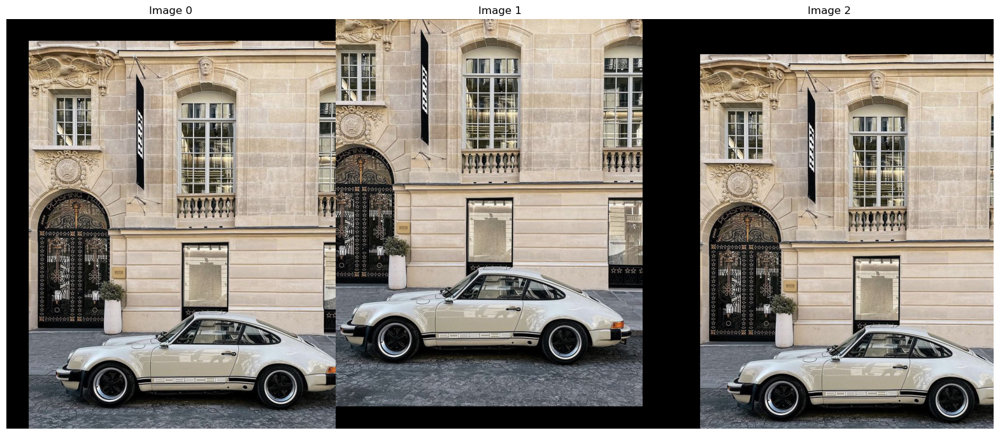

In [14]:
M = np.float32([[1, 0, 50],
                [0, 1, 50],
                [0, 0, 1]])

M1 = np.float32([[1, 0, -50],
                [0, 1, -50],
                [0, 0, 1]])

M2 = np.float32([[1, 0, 80],
                   [0, 1, 80],
                   [0, 0, 1]])

# apply a perspective transformation to the image
translated_img1 = cv2.warpPerspective(image_2, M, (cols, rows))
translated_img2 = cv2.warpPerspective(image_2, M1, (cols, rows))
translated_img3 = cv2.warpPerspective(image_2, M2, (cols, rows))

ShowImage([translated_img1, translated_img2, translated_img3], 1, 3)

## Shearing

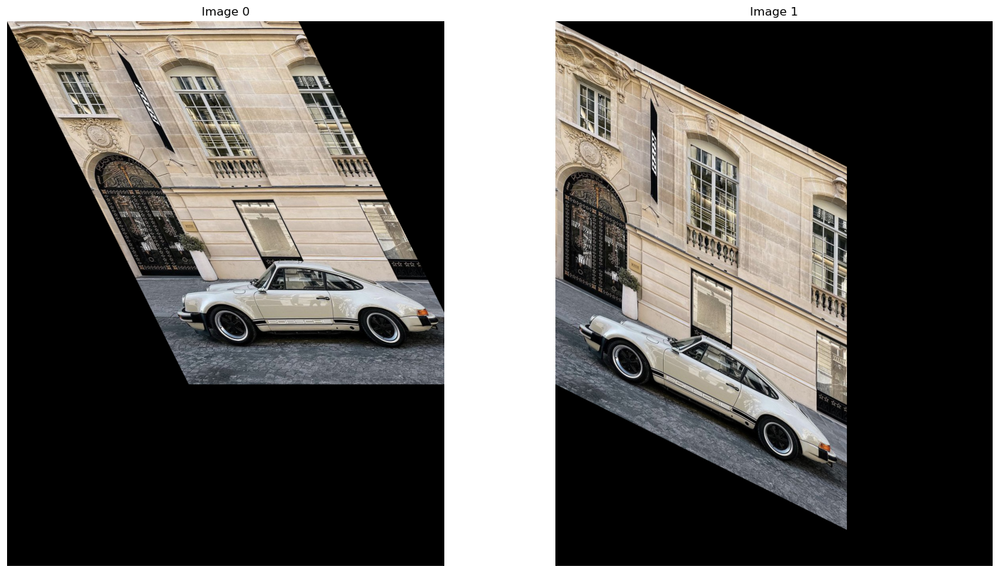

In [15]:
M = np.float32([[1, 0.5, 0],
                [0, 1  , 0],
                [0, 0  , 1]])
# shearing applied to y-axis
M1 = np.float32([[1,   0, 0],
                 [0.5, 1, 0],
                 [0,   0, 1]])
# apply a perspective transformation to the image                
sheared_img1 = cv2.warpPerspective(image_2,M,(int(cols*1.5),int(rows*1.5)))
sheared_img2 = cv2.warpPerspective(image_2,M1,(int(cols*1.5),int(rows*1.5)))

ShowImage([sheared_img1, sheared_img2], 1, 2)

# 3/ Cũng thực hiện nhân ma trận. Tạo các ma trận tổng hợp sau: 

## Scaling to Rotation

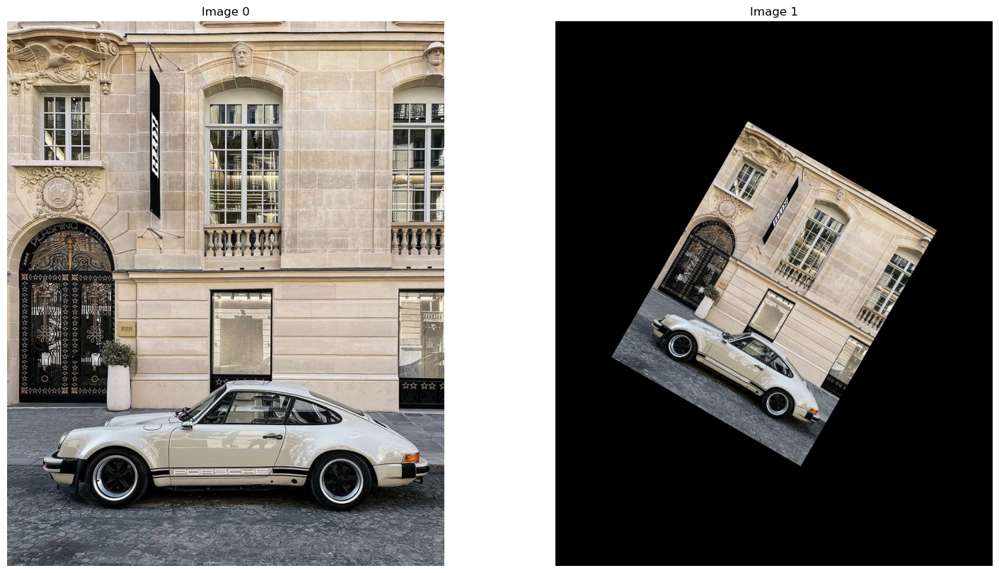

In [16]:
rows, cols, dim = image_2.shape
xc, yc = cols/2, rows/2

Translate = np.float32([[1, 0  , xc],
                        [0,   1, yc],
                        [0,   0,   1]])

Translate_op = np.float32([[1, 0  , -xc],
                        [0,   1, -yc],
                        [0,   0,   1]])
# scale
scale = np.float32([[0.5, 0  , 0],
                [0,   0.5, 0],
                [0,   0,   1]])

# rotate
angle = np.radians(30)
rotate = np.float32([[np.cos(angle), -(np.sin(angle)), 0],
                [np.sin(angle), np.cos(angle), 0],
                [0, 0, 1]])


M = Translate @ scale @ rotate @ Translate_op
scale_rotate = cv2.warpPerspective(image_2, M, (cols, rows))

ShowImage([image_2, scale_rotate], 1, 2)

## Rotation to Shearing 


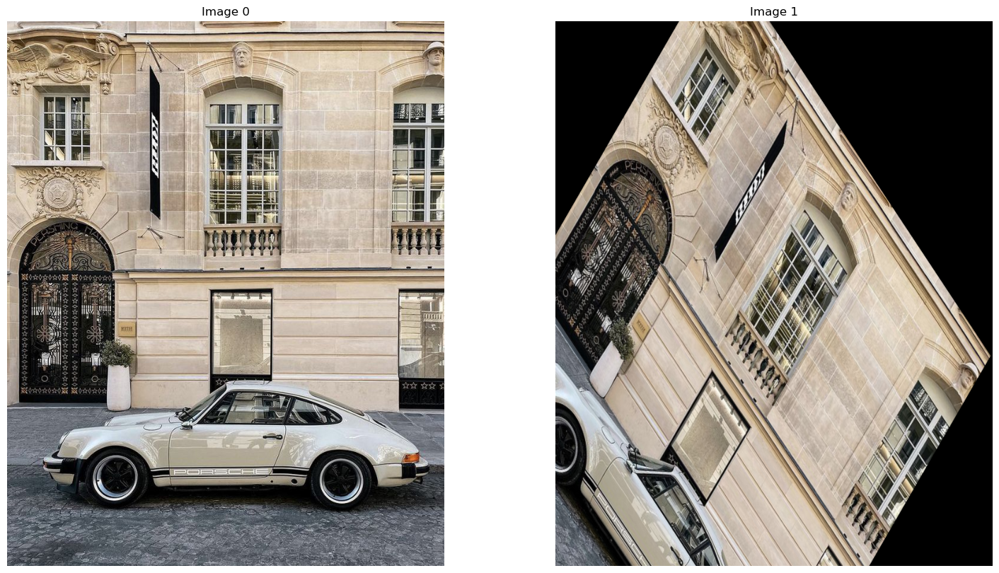

In [17]:
rows, cols, dim = image_2.shape
xc, yc = cols/2, rows/2

Translate = np.float32([[1, 0  , xc],
                        [0,   1, yc],
                        [0,   0,   1]])

Translate_op = np.float32([[1, 0  , -xc],
                        [0,   1, -yc],
                        [0,   0,   1]])
# shear
shear = np.float32([[1,   0, 0],
                    [0.5, 1, 0],
                    [0,   0, 1]])

# rotate
angle = np.radians(30)
rotate = np.float32([[np.cos(angle), -(np.sin(angle)), 0],
                [np.sin(angle), np.cos(angle), 0],
                [0, 0, 1]])


M = Translate @  rotate @ Translate_op @ shear
scale_rotate_img = cv2.warpPerspective(image_2, M, (cols, rows))

ShowImage([image_2, scale_rotate_img], 1, 2)

## Scaling to Rotation to Shearing


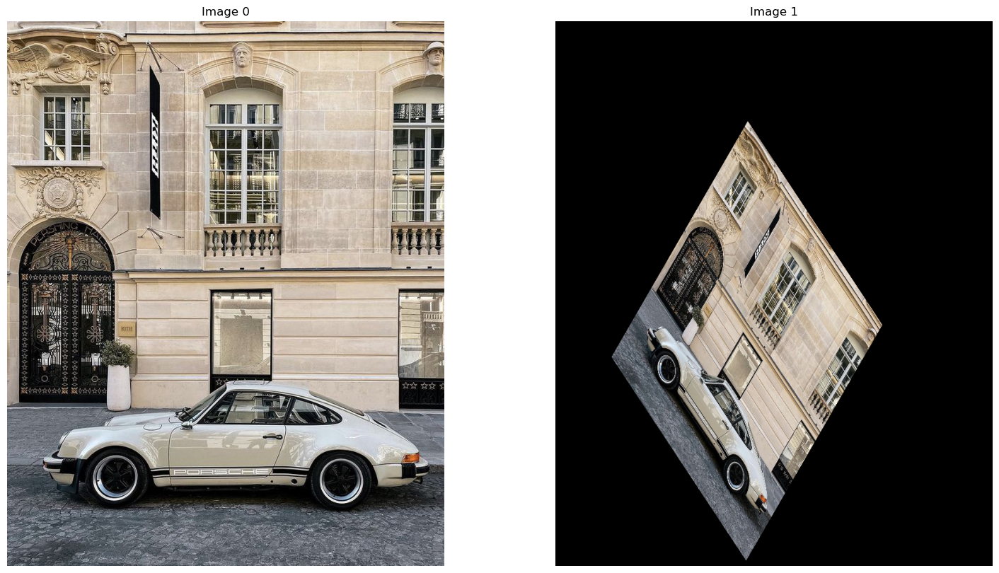

In [18]:
rows, cols, dim = image_2.shape
xc, yc = cols/2, rows/2

Translate = np.float32([[1, 0  , xc],
                        [0,   1, yc],
                        [0,   0,   1]])

Translate_op = np.float32([[1, 0  , -xc],
                        [0,   1, -yc],
                        [0,   0,   1]])

# scale
scale = np.float32([[0.5, 0  , 0],
                [0,   0.5, 0],
                [0,   0,   1]])

# shear
shear = np.float32([[1,   0, 0],
                    [0.5, 1, 0],
                    [0,   0, 1]])

# rotate
angle = np.radians(30)
rotate = np.float32([[np.cos(angle), -(np.sin(angle)), 0],
                [np.sin(angle), np.cos(angle), 0],
                [0, 0, 1]])


M = Translate @ scale @ rotate @ Translate_op @ shear
scale_rotate_img = cv2.warpPerspective(image_2, M, (cols, rows))

ShowImage([image_2, scale_rotate_img], 1, 2)

# 4/ Chụp một tấm ảnh bất kỳ từ điện thoại của bạn có chứa vật thể dạng hình chữ nhật hay hình vuông (ví dụ bức tranh, điện thoại, màn hình máy tính v.v…) (Lưu ý chụp nghiêng, xéo và không được chụp thẳng)


Width :  1920  Height :  2560  Channel :  3
Red - Min Intensity:  0  Max Intensity:  255
Green - Min Intensity:  0  Max Intensity:  255
Blue - Min Intensity:  0  Max Intensity:  255


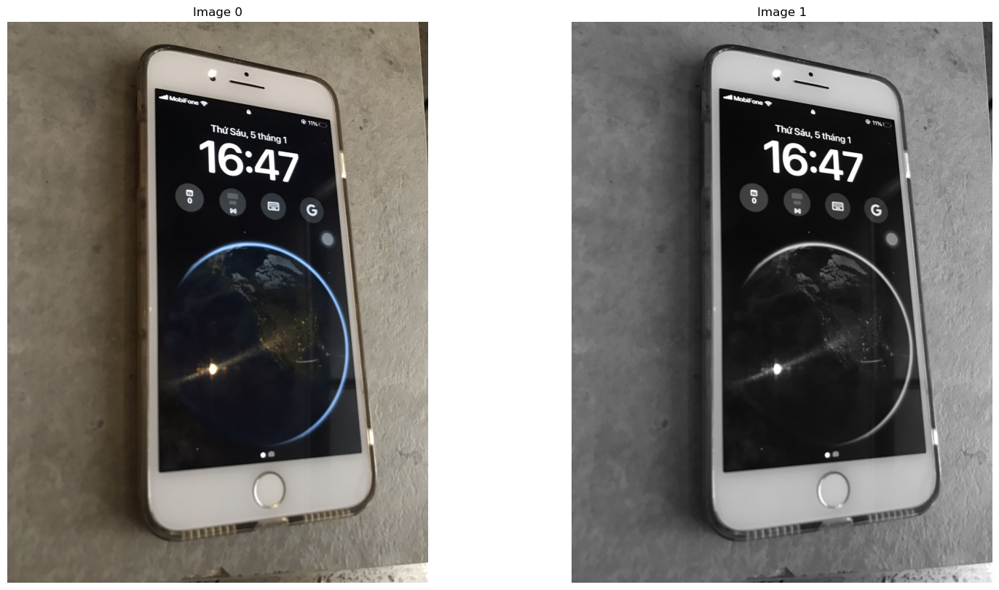

In [19]:
# Read Image 
image_3 = imread("iphone.jpg")
# Convert Image into Gray
image_gray_3 = cv2.cvtColor(image_3, cv2.COLOR_RGB2GRAY)

# Display Image
InfoImage(image_3)
ShowImage([image_3, image_gray_3], 1, 2)

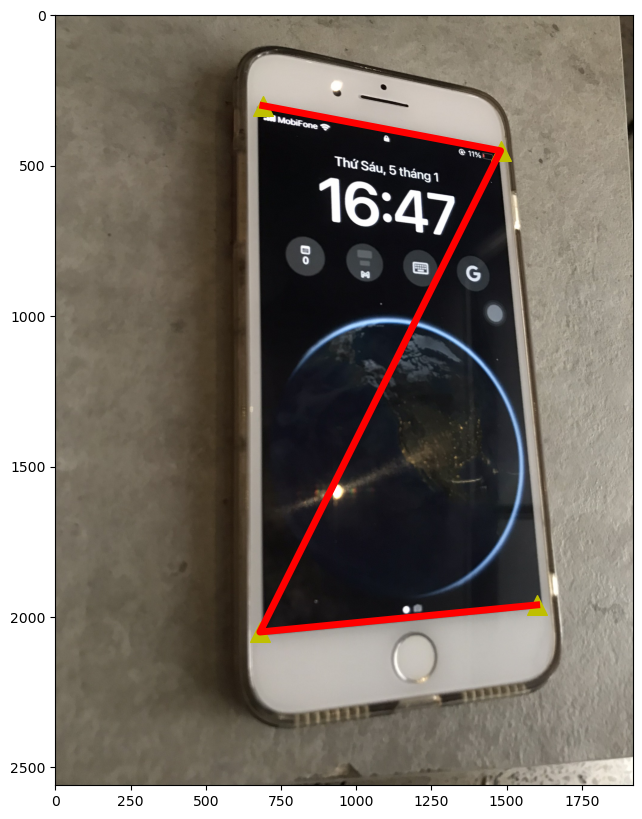

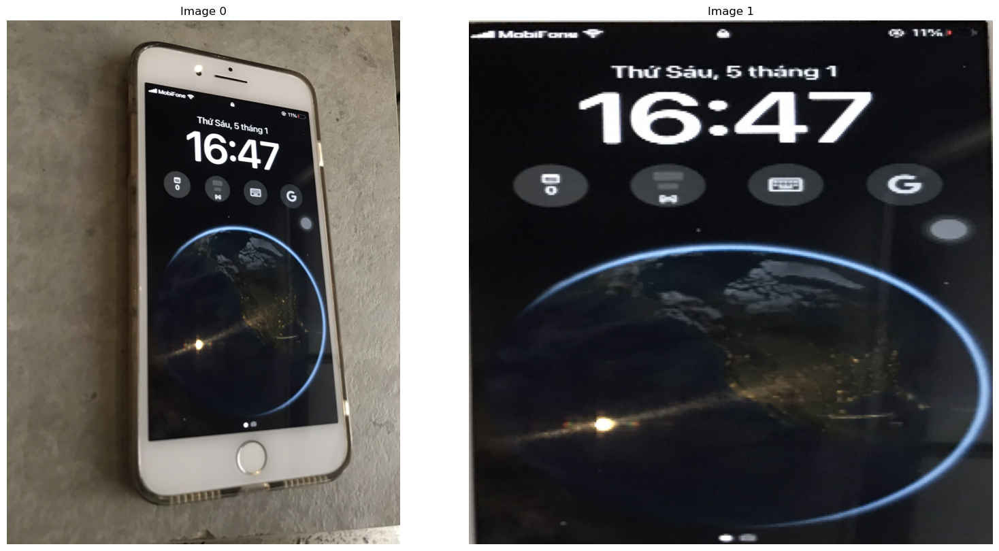

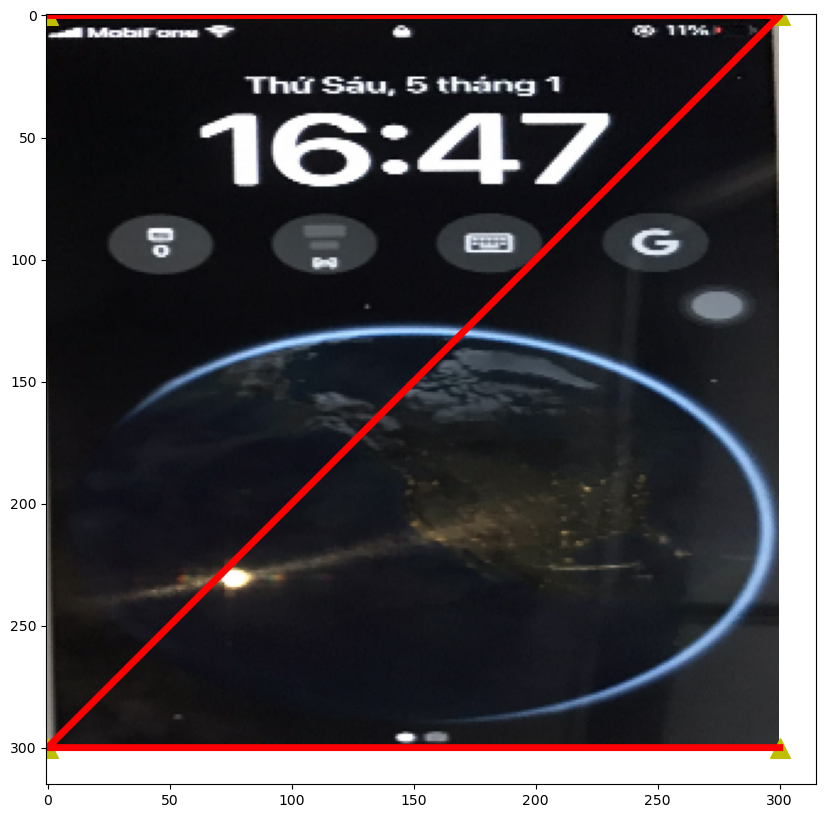

In [20]:
rows,cols,ch = image_3.shape

PointList_From = [[690,300],[1480,450],[680,2050],[1600,1960]]
PointList_To = [[0,0],[300,0],[0,300],[300,300]]

XList = []
YList = []

for pt in PointList_From:
    XList.append(pt[0])
    YList.append(pt[1])
    
plt.figure(figsize=(10,10))
plt.imshow(image_3)

plt.scatter(XList, YList, c='y', s=200, marker='^')
plt.plot(XList,YList,'r', linewidth=5, markersize=12)

plt.show()


pts1 = np.float32(PointList_From)
pts2 = np.float32(PointList_To)
MappingMatrix = cv2.getPerspectiveTransform(pts1,pts2)
image_Perspective = cv2.warpPerspective(image_3,MappingMatrix,(300,300))
ShowImage([image_3, image_Perspective], 1, 2)

XList = []
YList = []

for pt in PointList_To:
    XList.append(pt[0])
    YList.append(pt[1])
    
plt.figure(figsize=(10,10))
plt.imshow(image_Perspective)

plt.scatter(XList, YList, c='y', s=200, marker='^')
plt.plot(XList,YList,'r', linewidth=5, markersize=12)

plt.show()